## Installing Lucent

In [ ]:
!pip install --quiet git+https://github.com/atagade/lucent.git

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 225.1/225.1 KB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.8/227.8 KB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.4/214.4 KB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 35.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.1/317.1 KB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 316.8/316.8 KB 18.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 298.2/298.2 KB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.0/297.0 KB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.0/297.0 KB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.0/297.0 KB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.0/297.0 KB 15.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━

## Importing libraries

In [ ]:
import torch
import torchvision
from lucent.optvis import render, param, transform, objectives
from lucent.modelzoo.util import get_model_layers

## Importing custom ResNet-18 module to enable skipping batchnorms

In [ ]:
from lucent.modelzoo import custom_resnet

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

model = custom_resnet.resnet18(pretrained=True, skip_batchnorm=True).to(device).eval()

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

## Helper functions

In [ ]:
from typing import Callable, Dict, List, Optional, Tuple
import numpy as np
import matplotlib.pyplot as plt

from __future__ import absolute_import, division, print_function

import warnings
from collections import OrderedDict
import numpy as np
from tqdm import tqdm
from PIL import Image
import torch

from lucent.optvis import objectives, transform, param
from lucent.misc.io import show
from lucent.optvis.render import hook_model

def tensor_to_img_array(tensor):
    image = tensor.cpu().detach().numpy()
    image = np.transpose(image, [0, 2, 3, 1])
    return image

def view(tensor):
    image = tensor_to_img_array(tensor)
    assert len(image.shape) in [
        3,
        4,
    ], "Image should have 3 or 4 dimensions, invalid image shape {}".format(image.shape)
    # Change dtype for PIL.Image
    image = (image * 255).astype(np.uint8)
    if len(image.shape) == 4:
        image = np.concatenate(image, axis=1)
    Image.fromarray(image).show()


def export(tensor, image_name=None):
    image_name = image_name or "image.jpg"
    image = tensor_to_img_array(tensor)
    assert len(image.shape) in [
        3,
        4,
    ], "Image should have 3 or 4 dimensions, invalid image shape {}".format(image.shape)
    # Change dtype for PIL.Image
    image = (image * 255).astype(np.uint8)
    if len(image.shape) == 4:
        image = np.concatenate(image, axis=1)
    Image.fromarray(image).save(image_name)


## Visualising images that maximally activate a particular channel of a layer 

### Layer1

In [ ]:
param_f = lambda: param.image(224)

layer = 'layer1'
n_channels = 64

images = []

for n in range(n_channels):
  obj = objectives.channel(layer, n)
  image = render.render_vis(model, obj, param_f)
  images.append(image[0][0])

100%|██████████| 512/512 [00:10<00:00, 48.63it/s]


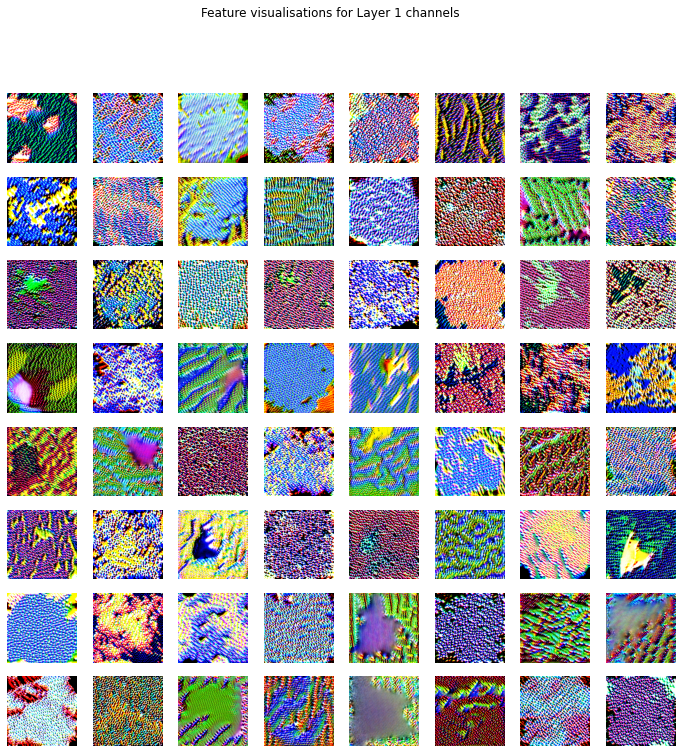

In [ ]:
fig, ax = plt.subplots(8, 8, figsize = (12, 12))
fig.suptitle('Feature visualisations for Layer 1 channels')
for i in range(8):
  for j in range(8):
    ax[i][j].axis('off')
    ax[i][j].imshow(images[8*i+j])

### Layer 2

In [ ]:
param_f = lambda: param.image(224)

layer = 'layer2'
n_channels = 128

images = []

for n in range(n_channels):
  print(f"{n+1}/{n_channels}")
  obj = objectives.channel(layer, n)
  image = render.render_vis(model, obj, param_f)
  images.append(image[0][0])

1/128


100%|██████████| 512/512 [00:11<00:00, 43.38it/s]


2/128


100%|██████████| 512/512 [00:11<00:00, 46.15it/s]


3/128


100%|██████████| 512/512 [00:11<00:00, 45.59it/s]


4/128


100%|██████████| 512/512 [00:10<00:00, 46.92it/s]


5/128


100%|██████████| 512/512 [00:10<00:00, 46.70it/s]


6/128


100%|██████████| 512/512 [00:12<00:00, 42.25it/s]


7/128


100%|██████████| 512/512 [00:11<00:00, 45.18it/s]


8/128


100%|██████████| 512/512 [00:11<00:00, 45.35it/s]


9/128


100%|██████████| 512/512 [00:11<00:00, 44.88it/s]


10/128


100%|██████████| 512/512 [00:11<00:00, 43.06it/s]


11/128


100%|██████████| 512/512 [00:11<00:00, 44.64it/s]


12/128


100%|██████████| 512/512 [00:11<00:00, 44.93it/s]


13/128


100%|██████████| 512/512 [00:11<00:00, 44.55it/s]


14/128


100%|██████████| 512/512 [00:11<00:00, 44.42it/s]


15/128


100%|██████████| 512/512 [00:11<00:00, 45.01it/s]


16/128


100%|██████████| 512/512 [00:11<00:00, 44.09it/s]


17/128


100%|██████████| 512/512 [00:11<00:00, 44.07it/s]


18/128


100%|██████████| 512/512 [00:11<00:00, 43.76it/s]


19/128


100%|██████████| 512/512 [00:11<00:00, 42.84it/s]


20/128


100%|██████████| 512/512 [00:11<00:00, 44.07it/s]


21/128


100%|██████████| 512/512 [00:11<00:00, 44.73it/s]


22/128


100%|██████████| 512/512 [00:11<00:00, 44.94it/s]


23/128


100%|██████████| 512/512 [00:11<00:00, 44.31it/s]


24/128


100%|██████████| 512/512 [00:11<00:00, 43.24it/s]


25/128


100%|██████████| 512/512 [00:11<00:00, 43.08it/s]


26/128


100%|██████████| 512/512 [00:11<00:00, 43.13it/s]


27/128


100%|██████████| 512/512 [00:11<00:00, 43.16it/s]


28/128


100%|██████████| 512/512 [00:11<00:00, 43.24it/s]


29/128


100%|██████████| 512/512 [00:11<00:00, 43.35it/s]


30/128


100%|██████████| 512/512 [00:11<00:00, 43.04it/s]


31/128


100%|██████████| 512/512 [00:11<00:00, 43.15it/s]


32/128


100%|██████████| 512/512 [00:12<00:00, 42.37it/s]


33/128


100%|██████████| 512/512 [00:12<00:00, 42.39it/s]


34/128


100%|██████████| 512/512 [00:12<00:00, 42.46it/s]


35/128


100%|██████████| 512/512 [00:11<00:00, 43.27it/s]


36/128


100%|██████████| 512/512 [00:11<00:00, 43.06it/s]


37/128


100%|██████████| 512/512 [00:11<00:00, 43.03it/s]


38/128


100%|██████████| 512/512 [00:11<00:00, 42.86it/s]


39/128


100%|██████████| 512/512 [00:12<00:00, 42.39it/s]


40/128


100%|██████████| 512/512 [00:12<00:00, 42.61it/s]


41/128


100%|██████████| 512/512 [00:11<00:00, 43.01it/s]


42/128


100%|██████████| 512/512 [00:12<00:00, 42.61it/s]


43/128


100%|██████████| 512/512 [00:12<00:00, 42.29it/s]


44/128


100%|██████████| 512/512 [00:12<00:00, 42.01it/s]


45/128


100%|██████████| 512/512 [00:12<00:00, 40.89it/s]


46/128


100%|██████████| 512/512 [00:12<00:00, 42.05it/s]


47/128


100%|██████████| 512/512 [00:12<00:00, 42.66it/s]


48/128


100%|██████████| 512/512 [00:12<00:00, 42.25it/s]


49/128


100%|██████████| 512/512 [00:12<00:00, 42.58it/s]


50/128


100%|██████████| 512/512 [00:12<00:00, 42.18it/s]


51/128


100%|██████████| 512/512 [00:12<00:00, 42.40it/s]


52/128


100%|██████████| 512/512 [00:12<00:00, 42.13it/s]


53/128


100%|██████████| 512/512 [00:12<00:00, 41.91it/s]


54/128


100%|██████████| 512/512 [00:12<00:00, 41.20it/s]


55/128


100%|██████████| 512/512 [00:12<00:00, 41.34it/s]


56/128


100%|██████████| 512/512 [00:12<00:00, 41.68it/s]


57/128


100%|██████████| 512/512 [00:12<00:00, 41.94it/s]


58/128


100%|██████████| 512/512 [00:12<00:00, 39.48it/s]


59/128


100%|██████████| 512/512 [00:13<00:00, 38.65it/s]


60/128


100%|██████████| 512/512 [00:14<00:00, 36.09it/s]


61/128


100%|██████████| 512/512 [00:13<00:00, 38.07it/s]


62/128


100%|██████████| 512/512 [00:12<00:00, 39.84it/s]


63/128


100%|██████████| 512/512 [00:12<00:00, 39.39it/s]


64/128


100%|██████████| 512/512 [00:13<00:00, 38.69it/s]


65/128


100%|██████████| 512/512 [00:13<00:00, 39.20it/s]


66/128


100%|██████████| 512/512 [00:12<00:00, 39.61it/s]


67/128


100%|██████████| 512/512 [00:12<00:00, 40.28it/s]


68/128


100%|██████████| 512/512 [00:12<00:00, 40.96it/s]


69/128


100%|██████████| 512/512 [00:13<00:00, 38.92it/s]


70/128


100%|██████████| 512/512 [00:12<00:00, 39.48it/s]


71/128


100%|██████████| 512/512 [00:12<00:00, 39.89it/s]


72/128


100%|██████████| 512/512 [00:12<00:00, 40.17it/s]


73/128


100%|██████████| 512/512 [00:12<00:00, 40.41it/s]


74/128


100%|██████████| 512/512 [00:12<00:00, 40.32it/s]


75/128


100%|██████████| 512/512 [00:12<00:00, 40.22it/s]


76/128


100%|██████████| 512/512 [00:12<00:00, 40.37it/s]


77/128


100%|██████████| 512/512 [00:12<00:00, 39.71it/s]


78/128


100%|██████████| 512/512 [00:12<00:00, 39.82it/s]


79/128


100%|██████████| 512/512 [00:12<00:00, 39.44it/s]


80/128


100%|██████████| 512/512 [00:12<00:00, 39.80it/s]


81/128


100%|██████████| 512/512 [00:12<00:00, 39.64it/s]


82/128


100%|██████████| 512/512 [00:12<00:00, 39.65it/s]


83/128


100%|██████████| 512/512 [00:12<00:00, 39.79it/s]


84/128


100%|██████████| 512/512 [00:13<00:00, 37.27it/s]


85/128


100%|██████████| 512/512 [00:13<00:00, 38.05it/s]


86/128


100%|██████████| 512/512 [00:13<00:00, 38.20it/s]


87/128


100%|██████████| 512/512 [00:13<00:00, 38.60it/s]


88/128


100%|██████████| 512/512 [00:12<00:00, 39.48it/s]


89/128


100%|██████████| 512/512 [00:12<00:00, 39.46it/s]


90/128


100%|██████████| 512/512 [00:13<00:00, 38.50it/s]


91/128


100%|██████████| 512/512 [00:13<00:00, 38.90it/s]


92/128


100%|██████████| 512/512 [00:13<00:00, 38.59it/s]


93/128


100%|██████████| 512/512 [00:13<00:00, 38.43it/s]


94/128


100%|██████████| 512/512 [00:13<00:00, 38.25it/s]


95/128


100%|██████████| 512/512 [00:13<00:00, 37.43it/s]


96/128


100%|██████████| 512/512 [00:13<00:00, 36.63it/s]


97/128


100%|██████████| 512/512 [00:13<00:00, 38.52it/s]


98/128


100%|██████████| 512/512 [00:13<00:00, 38.41it/s]


99/128


100%|██████████| 512/512 [00:13<00:00, 38.38it/s]


100/128


100%|██████████| 512/512 [00:13<00:00, 38.45it/s]


101/128


100%|██████████| 512/512 [00:13<00:00, 38.20it/s]


102/128


100%|██████████| 512/512 [00:13<00:00, 37.72it/s]


103/128


100%|██████████| 512/512 [00:13<00:00, 38.20it/s]


104/128


100%|██████████| 512/512 [00:13<00:00, 38.22it/s]


105/128


100%|██████████| 512/512 [00:13<00:00, 37.23it/s]


106/128


100%|██████████| 512/512 [00:14<00:00, 36.49it/s]


107/128


100%|██████████| 512/512 [00:13<00:00, 37.57it/s]


108/128


100%|██████████| 512/512 [00:13<00:00, 37.66it/s]


109/128


100%|██████████| 512/512 [00:13<00:00, 37.59it/s]


110/128


100%|██████████| 512/512 [00:13<00:00, 38.15it/s]


111/128


100%|██████████| 512/512 [00:13<00:00, 37.25it/s]


112/128


100%|██████████| 512/512 [00:13<00:00, 37.57it/s]


113/128


100%|██████████| 512/512 [00:14<00:00, 36.38it/s]


114/128


100%|██████████| 512/512 [00:14<00:00, 35.25it/s]


115/128


100%|██████████| 512/512 [00:13<00:00, 37.16it/s]


116/128


100%|██████████| 512/512 [00:14<00:00, 36.54it/s]


117/128


100%|██████████| 512/512 [00:13<00:00, 36.73it/s]


118/128


100%|██████████| 512/512 [00:14<00:00, 36.52it/s]


119/128


100%|██████████| 512/512 [00:19<00:00, 25.77it/s]


120/128


100%|██████████| 512/512 [00:14<00:00, 35.20it/s]


121/128


100%|██████████| 512/512 [00:14<00:00, 35.82it/s]


122/128


100%|██████████| 512/512 [00:14<00:00, 36.24it/s]


123/128


100%|██████████| 512/512 [00:14<00:00, 34.59it/s]


124/128


100%|██████████| 512/512 [00:14<00:00, 34.84it/s]


125/128


100%|██████████| 512/512 [00:14<00:00, 35.19it/s]


126/128


100%|██████████| 512/512 [00:14<00:00, 35.82it/s]


127/128


100%|██████████| 512/512 [00:14<00:00, 36.13it/s]


128/128


100%|██████████| 512/512 [00:14<00:00, 35.49it/s]


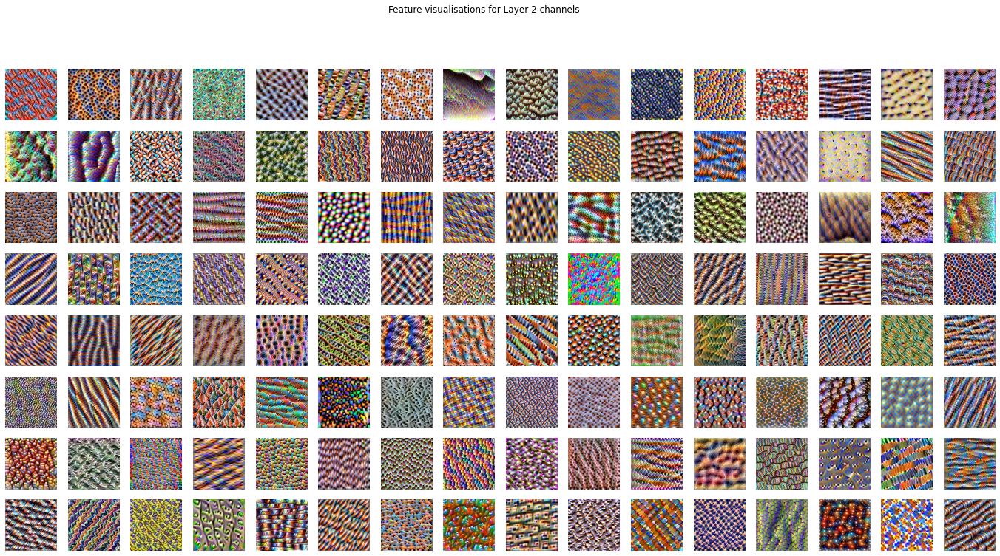

In [ ]:
fig, ax = plt.subplots(8, 16, figsize = (24, 12))
fig.suptitle('Feature visualisations for Layer 2 channels')
for i in range(8):
  for j in range(16):
    ax[i][j].axis('off')
    ax[i][j].imshow(images[16*i+j])

### Layer 3

In [ ]:
param_f = lambda: param.image(224)

layer = 'layer3'
n_channels = 256

images = []

for n in range(n_channels):
  print(f"{n+1}/{n_channels}")
  obj = objectives.channel(layer, n)
  image = render.render_vis(model, obj, param_f)
  images.append(image[0][0])

1/256


100%|██████████| 512/512 [00:17<00:00, 29.58it/s]


2/256


100%|██████████| 512/512 [00:16<00:00, 31.61it/s]


3/256


100%|██████████| 512/512 [00:15<00:00, 32.66it/s]


4/256


100%|██████████| 512/512 [00:15<00:00, 33.78it/s]


5/256


100%|██████████| 512/512 [00:15<00:00, 33.59it/s]


6/256


100%|██████████| 512/512 [00:15<00:00, 33.37it/s]


7/256


100%|██████████| 512/512 [00:15<00:00, 32.86it/s]


8/256


100%|██████████| 512/512 [00:15<00:00, 34.02it/s]


9/256


100%|██████████| 512/512 [00:15<00:00, 33.46it/s]


10/256


100%|██████████| 512/512 [00:15<00:00, 32.56it/s]


11/256


100%|██████████| 512/512 [00:15<00:00, 33.49it/s]


12/256


100%|██████████| 512/512 [00:15<00:00, 33.97it/s]


13/256


100%|██████████| 512/512 [00:15<00:00, 33.99it/s]


14/256


100%|██████████| 512/512 [00:15<00:00, 33.01it/s]


15/256


100%|██████████| 512/512 [00:15<00:00, 32.62it/s]


16/256


100%|██████████| 512/512 [00:15<00:00, 33.81it/s]


17/256


100%|██████████| 512/512 [00:15<00:00, 33.89it/s]


18/256


100%|██████████| 512/512 [00:16<00:00, 31.76it/s]


19/256


100%|██████████| 512/512 [00:15<00:00, 33.59it/s]


20/256


100%|██████████| 512/512 [00:15<00:00, 32.30it/s]


21/256


100%|██████████| 512/512 [00:15<00:00, 32.90it/s]


22/256


100%|██████████| 512/512 [00:16<00:00, 32.00it/s]


23/256


100%|██████████| 512/512 [00:15<00:00, 33.69it/s]


24/256


100%|██████████| 512/512 [00:15<00:00, 33.26it/s]


25/256


100%|██████████| 512/512 [00:16<00:00, 30.81it/s]


26/256


100%|██████████| 512/512 [00:15<00:00, 33.01it/s]


27/256


100%|██████████| 512/512 [00:15<00:00, 33.52it/s]


28/256


100%|██████████| 512/512 [00:15<00:00, 33.19it/s]


29/256


100%|██████████| 512/512 [00:16<00:00, 31.24it/s]


30/256


100%|██████████| 512/512 [00:15<00:00, 32.84it/s]


31/256


100%|██████████| 512/512 [00:15<00:00, 32.48it/s]


32/256


100%|██████████| 512/512 [00:16<00:00, 31.33it/s]


33/256


100%|██████████| 512/512 [00:15<00:00, 32.73it/s]


34/256


100%|██████████| 512/512 [00:15<00:00, 33.15it/s]


35/256


100%|██████████| 512/512 [00:16<00:00, 31.81it/s]


36/256


100%|██████████| 512/512 [00:16<00:00, 31.80it/s]


37/256


100%|██████████| 512/512 [00:15<00:00, 32.81it/s]


38/256


100%|██████████| 512/512 [00:15<00:00, 33.25it/s]


39/256


100%|██████████| 512/512 [00:16<00:00, 31.07it/s]


40/256


100%|██████████| 512/512 [00:15<00:00, 32.60it/s]


41/256


100%|██████████| 512/512 [00:15<00:00, 32.37it/s]


42/256


100%|██████████| 512/512 [00:16<00:00, 31.30it/s]


43/256


100%|██████████| 512/512 [00:15<00:00, 32.36it/s]


44/256


100%|██████████| 512/512 [00:15<00:00, 32.65it/s]


45/256


100%|██████████| 512/512 [00:16<00:00, 30.99it/s]


46/256


100%|██████████| 512/512 [00:15<00:00, 32.56it/s]


47/256


100%|██████████| 512/512 [00:15<00:00, 32.39it/s]


48/256


100%|██████████| 512/512 [00:16<00:00, 30.42it/s]


49/256


100%|██████████| 512/512 [00:15<00:00, 32.06it/s]


50/256


100%|██████████| 512/512 [00:16<00:00, 31.92it/s]


51/256


100%|██████████| 512/512 [00:16<00:00, 30.88it/s]


52/256


100%|██████████| 512/512 [00:16<00:00, 31.32it/s]


53/256


100%|██████████| 512/512 [00:16<00:00, 31.65it/s]


54/256


100%|██████████| 512/512 [00:16<00:00, 30.23it/s]


55/256


100%|██████████| 512/512 [00:16<00:00, 31.63it/s]


56/256


100%|██████████| 512/512 [00:16<00:00, 31.68it/s]


57/256


100%|██████████| 512/512 [00:16<00:00, 30.44it/s]


58/256


100%|██████████| 512/512 [00:16<00:00, 31.87it/s]


59/256


100%|██████████| 512/512 [00:16<00:00, 31.40it/s]


60/256


100%|██████████| 512/512 [00:17<00:00, 29.99it/s]


61/256


100%|██████████| 512/512 [00:16<00:00, 31.12it/s]


62/256


100%|██████████| 512/512 [00:16<00:00, 31.42it/s]


63/256


100%|██████████| 512/512 [00:17<00:00, 29.75it/s]


64/256


100%|██████████| 512/512 [00:16<00:00, 31.61it/s]


65/256


100%|██████████| 512/512 [00:17<00:00, 29.99it/s]


66/256


100%|██████████| 512/512 [00:16<00:00, 30.66it/s]


67/256


100%|██████████| 512/512 [00:16<00:00, 30.88it/s]


68/256


100%|██████████| 512/512 [00:17<00:00, 29.55it/s]


69/256


100%|██████████| 512/512 [00:16<00:00, 30.98it/s]


70/256


100%|██████████| 512/512 [00:16<00:00, 30.78it/s]


71/256


100%|██████████| 512/512 [00:17<00:00, 29.61it/s]


72/256


100%|██████████| 512/512 [00:16<00:00, 30.82it/s]


73/256


100%|██████████| 512/512 [00:17<00:00, 29.63it/s]


74/256


100%|██████████| 512/512 [00:16<00:00, 30.41it/s]


75/256


100%|██████████| 512/512 [00:16<00:00, 30.70it/s]


76/256


100%|██████████| 512/512 [00:17<00:00, 29.40it/s]


77/256


100%|██████████| 512/512 [00:16<00:00, 30.74it/s]


78/256


100%|██████████| 512/512 [00:17<00:00, 29.92it/s]


79/256


100%|██████████| 512/512 [00:16<00:00, 30.20it/s]


80/256


100%|██████████| 512/512 [00:16<00:00, 30.33it/s]


81/256


100%|██████████| 512/512 [00:17<00:00, 29.18it/s]


82/256


100%|██████████| 512/512 [00:16<00:00, 30.50it/s]


83/256


100%|██████████| 512/512 [00:17<00:00, 29.05it/s]


84/256


100%|██████████| 512/512 [00:17<00:00, 29.98it/s]


85/256


100%|██████████| 512/512 [00:17<00:00, 30.09it/s]


86/256


100%|██████████| 512/512 [00:17<00:00, 28.59it/s]


87/256


100%|██████████| 512/512 [00:17<00:00, 30.09it/s]


88/256


100%|██████████| 512/512 [00:17<00:00, 28.75it/s]


89/256


100%|██████████| 512/512 [00:17<00:00, 29.95it/s]


90/256


100%|██████████| 512/512 [00:17<00:00, 28.84it/s]


91/256


100%|██████████| 512/512 [00:17<00:00, 29.47it/s]


92/256


100%|██████████| 512/512 [00:17<00:00, 29.77it/s]


93/256


100%|██████████| 512/512 [00:17<00:00, 28.69it/s]


94/256


100%|██████████| 512/512 [00:17<00:00, 30.05it/s]


95/256


100%|██████████| 512/512 [00:17<00:00, 28.60it/s]


96/256


100%|██████████| 512/512 [00:17<00:00, 30.09it/s]


97/256


100%|██████████| 512/512 [00:18<00:00, 28.37it/s]


98/256


100%|██████████| 512/512 [00:17<00:00, 29.42it/s]


99/256


100%|██████████| 512/512 [00:17<00:00, 29.59it/s]


100/256


100%|██████████| 512/512 [00:17<00:00, 28.73it/s]


101/256


100%|██████████| 512/512 [00:17<00:00, 29.60it/s]


102/256


100%|██████████| 512/512 [00:18<00:00, 27.98it/s]


103/256


100%|██████████| 512/512 [00:17<00:00, 29.18it/s]


104/256


100%|██████████| 512/512 [00:18<00:00, 28.07it/s]


105/256


100%|██████████| 512/512 [00:17<00:00, 29.67it/s]


106/256


100%|██████████| 512/512 [00:18<00:00, 28.37it/s]


107/256


100%|██████████| 512/512 [00:17<00:00, 28.75it/s]


108/256


100%|██████████| 512/512 [00:18<00:00, 28.17it/s]


109/256


100%|██████████| 512/512 [00:17<00:00, 29.23it/s]


110/256


100%|██████████| 512/512 [00:17<00:00, 28.62it/s]


111/256


100%|██████████| 512/512 [00:18<00:00, 28.28it/s]


112/256


100%|██████████| 512/512 [00:17<00:00, 29.12it/s]


113/256


100%|██████████| 512/512 [00:18<00:00, 27.88it/s]


114/256


100%|██████████| 512/512 [00:17<00:00, 29.02it/s]


115/256


100%|██████████| 512/512 [00:18<00:00, 27.85it/s]


116/256


100%|██████████| 512/512 [00:18<00:00, 28.34it/s]


117/256


100%|██████████| 512/512 [00:18<00:00, 27.28it/s]


118/256


100%|██████████| 512/512 [00:17<00:00, 28.80it/s]


119/256


100%|██████████| 512/512 [00:19<00:00, 26.86it/s]


120/256


100%|██████████| 512/512 [00:18<00:00, 28.24it/s]


121/256


100%|██████████| 512/512 [00:19<00:00, 26.54it/s]


122/256


100%|██████████| 512/512 [00:18<00:00, 28.14it/s]


123/256


100%|██████████| 512/512 [00:18<00:00, 27.13it/s]


124/256


100%|██████████| 512/512 [00:19<00:00, 26.89it/s]


125/256


100%|██████████| 512/512 [00:18<00:00, 27.41it/s]


126/256


100%|██████████| 512/512 [00:19<00:00, 26.65it/s]


127/256


100%|██████████| 512/512 [00:18<00:00, 27.85it/s]


128/256


100%|██████████| 512/512 [00:19<00:00, 26.89it/s]


129/256


100%|██████████| 512/512 [00:18<00:00, 27.70it/s]


130/256


100%|██████████| 512/512 [00:19<00:00, 26.56it/s]


131/256


100%|██████████| 512/512 [00:18<00:00, 27.95it/s]


132/256


100%|██████████| 512/512 [00:19<00:00, 26.71it/s]


133/256


100%|██████████| 512/512 [00:18<00:00, 27.67it/s]


134/256


100%|██████████| 512/512 [00:19<00:00, 26.45it/s]


135/256


100%|██████████| 512/512 [00:19<00:00, 26.41it/s]


136/256


100%|██████████| 512/512 [00:18<00:00, 27.13it/s]


137/256


100%|██████████| 512/512 [00:19<00:00, 25.76it/s]


138/256


100%|██████████| 512/512 [00:18<00:00, 27.44it/s]


139/256


100%|██████████| 512/512 [00:19<00:00, 26.25it/s]


140/256


100%|██████████| 512/512 [00:18<00:00, 27.31it/s]


141/256


100%|██████████| 512/512 [00:19<00:00, 26.09it/s]


142/256


100%|██████████| 512/512 [00:19<00:00, 25.76it/s]


143/256


100%|██████████| 512/512 [00:19<00:00, 26.70it/s]


144/256


100%|██████████| 512/512 [00:19<00:00, 26.41it/s]


145/256


100%|██████████| 512/512 [00:19<00:00, 26.92it/s]


146/256


100%|██████████| 512/512 [00:19<00:00, 25.85it/s]


147/256


100%|██████████| 512/512 [00:19<00:00, 26.65it/s]


148/256


100%|██████████| 512/512 [00:19<00:00, 26.76it/s]


149/256


100%|██████████| 512/512 [00:19<00:00, 26.16it/s]


150/256


100%|██████████| 512/512 [00:18<00:00, 27.17it/s]


151/256


100%|██████████| 512/512 [00:19<00:00, 26.27it/s]


152/256


100%|██████████| 512/512 [00:18<00:00, 27.14it/s]


153/256


100%|██████████| 512/512 [00:19<00:00, 25.84it/s]


154/256


100%|██████████| 512/512 [00:19<00:00, 25.82it/s]


155/256


100%|██████████| 512/512 [00:19<00:00, 26.68it/s]


156/256


100%|██████████| 512/512 [00:19<00:00, 25.86it/s]


157/256


100%|██████████| 512/512 [00:18<00:00, 27.27it/s]


158/256


100%|██████████| 512/512 [00:20<00:00, 25.29it/s]


159/256


100%|██████████| 512/512 [00:19<00:00, 25.70it/s]


160/256


100%|██████████| 512/512 [00:19<00:00, 26.77it/s]


161/256


100%|██████████| 512/512 [00:19<00:00, 26.19it/s]


162/256


100%|██████████| 512/512 [00:18<00:00, 27.24it/s]


163/256


100%|██████████| 512/512 [00:19<00:00, 25.84it/s]


164/256


100%|██████████| 512/512 [00:20<00:00, 25.56it/s]


165/256


100%|██████████| 512/512 [00:18<00:00, 27.34it/s]


166/256


100%|██████████| 512/512 [00:19<00:00, 26.38it/s]


167/256


100%|██████████| 512/512 [00:18<00:00, 27.05it/s]


168/256


100%|██████████| 512/512 [00:19<00:00, 26.17it/s]


169/256


100%|██████████| 512/512 [00:19<00:00, 25.81it/s]


170/256


100%|██████████| 512/512 [00:19<00:00, 26.75it/s]


171/256


100%|██████████| 512/512 [00:20<00:00, 25.60it/s]


172/256


100%|██████████| 512/512 [00:18<00:00, 27.01it/s]


173/256


100%|██████████| 512/512 [00:19<00:00, 25.95it/s]


174/256


100%|██████████| 512/512 [00:19<00:00, 25.74it/s]


175/256


100%|██████████| 512/512 [00:19<00:00, 25.98it/s]


176/256


100%|██████████| 512/512 [00:22<00:00, 22.90it/s]


177/256


100%|██████████| 512/512 [00:23<00:00, 21.87it/s]


178/256


100%|██████████| 512/512 [00:21<00:00, 23.59it/s]


179/256


100%|██████████| 512/512 [00:22<00:00, 23.04it/s]


180/256


100%|██████████| 512/512 [00:20<00:00, 25.11it/s]


181/256


100%|██████████| 512/512 [00:23<00:00, 21.74it/s]


182/256


100%|██████████| 512/512 [00:22<00:00, 22.99it/s]


183/256


100%|██████████| 512/512 [00:20<00:00, 24.74it/s]


184/256


100%|██████████| 512/512 [00:20<00:00, 25.35it/s]


185/256


100%|██████████| 512/512 [00:20<00:00, 24.67it/s]


186/256


100%|██████████| 512/512 [00:21<00:00, 24.17it/s]


187/256


100%|██████████| 512/512 [00:21<00:00, 23.51it/s]


188/256


100%|██████████| 512/512 [00:21<00:00, 24.23it/s]


189/256


100%|██████████| 512/512 [00:24<00:00, 21.00it/s]


190/256


100%|██████████| 512/512 [00:21<00:00, 23.95it/s]


191/256


100%|██████████| 512/512 [00:22<00:00, 22.77it/s]


192/256


100%|██████████| 512/512 [00:21<00:00, 23.56it/s]


193/256


100%|██████████| 512/512 [00:20<00:00, 24.48it/s]


194/256


100%|██████████| 512/512 [00:21<00:00, 24.11it/s]


195/256


100%|██████████| 512/512 [00:21<00:00, 23.92it/s]


196/256


100%|██████████| 512/512 [00:21<00:00, 23.77it/s]


197/256


100%|██████████| 512/512 [00:21<00:00, 23.62it/s]


198/256


100%|██████████| 512/512 [00:22<00:00, 22.90it/s]


199/256


100%|██████████| 512/512 [00:22<00:00, 22.75it/s]


200/256


100%|██████████| 512/512 [00:22<00:00, 23.23it/s]


201/256


100%|██████████| 512/512 [00:21<00:00, 23.54it/s]


202/256


100%|██████████| 512/512 [00:21<00:00, 23.74it/s]


203/256


100%|██████████| 512/512 [00:20<00:00, 24.68it/s]


204/256


100%|██████████| 512/512 [00:21<00:00, 23.42it/s]


205/256


100%|██████████| 512/512 [00:21<00:00, 24.02it/s]


206/256


100%|██████████| 512/512 [00:21<00:00, 24.35it/s]


207/256


100%|██████████| 512/512 [00:20<00:00, 24.47it/s]


208/256


100%|██████████| 512/512 [00:21<00:00, 23.31it/s]


209/256


100%|██████████| 512/512 [00:23<00:00, 22.06it/s]


210/256


100%|██████████| 512/512 [00:22<00:00, 22.33it/s]


211/256


100%|██████████| 512/512 [00:23<00:00, 21.98it/s]


212/256


100%|██████████| 512/512 [00:24<00:00, 21.21it/s]


213/256


100%|██████████| 512/512 [00:22<00:00, 23.01it/s]


214/256


100%|██████████| 512/512 [00:21<00:00, 23.73it/s]


215/256


100%|██████████| 512/512 [00:23<00:00, 22.25it/s]


216/256


100%|██████████| 512/512 [00:23<00:00, 21.44it/s]


217/256


100%|██████████| 512/512 [00:23<00:00, 21.36it/s]


218/256


100%|██████████| 512/512 [00:24<00:00, 21.02it/s]


219/256


100%|██████████| 512/512 [00:24<00:00, 21.15it/s]


220/256


100%|██████████| 512/512 [00:23<00:00, 22.19it/s]


221/256


100%|██████████| 512/512 [00:22<00:00, 23.09it/s]


222/256


100%|██████████| 512/512 [00:24<00:00, 21.21it/s]


223/256


100%|██████████| 512/512 [00:24<00:00, 20.81it/s]


224/256


100%|██████████| 512/512 [00:24<00:00, 20.93it/s]


225/256


100%|██████████| 512/512 [00:24<00:00, 20.92it/s]


226/256


100%|██████████| 512/512 [00:21<00:00, 23.54it/s]


227/256


100%|██████████| 512/512 [00:24<00:00, 20.98it/s]


228/256


100%|██████████| 512/512 [00:26<00:00, 19.32it/s]


229/256


100%|██████████| 512/512 [00:24<00:00, 20.90it/s]


230/256


100%|██████████| 512/512 [00:21<00:00, 23.55it/s]


231/256


100%|██████████| 512/512 [00:21<00:00, 23.71it/s]


232/256


100%|██████████| 512/512 [00:21<00:00, 24.24it/s]


233/256


100%|██████████| 512/512 [00:21<00:00, 23.46it/s]


234/256


100%|██████████| 512/512 [00:21<00:00, 23.56it/s]


235/256


100%|██████████| 512/512 [00:21<00:00, 23.61it/s]


236/256


100%|██████████| 512/512 [00:21<00:00, 24.29it/s]


237/256


100%|██████████| 512/512 [00:21<00:00, 23.48it/s]


238/256


100%|██████████| 512/512 [00:22<00:00, 23.23it/s]


239/256


100%|██████████| 512/512 [00:22<00:00, 23.15it/s]


240/256


100%|██████████| 512/512 [00:21<00:00, 23.42it/s]


241/256


100%|██████████| 512/512 [00:21<00:00, 24.13it/s]


242/256


100%|██████████| 512/512 [00:21<00:00, 23.37it/s]


243/256


100%|██████████| 512/512 [00:22<00:00, 23.18it/s]


244/256


100%|██████████| 512/512 [00:22<00:00, 22.88it/s]


245/256


100%|██████████| 512/512 [00:21<00:00, 23.51it/s]


246/256


100%|██████████| 512/512 [00:21<00:00, 23.61it/s]


247/256


100%|██████████| 512/512 [00:22<00:00, 23.20it/s]


248/256


100%|██████████| 512/512 [00:22<00:00, 23.07it/s]


249/256


100%|██████████| 512/512 [00:22<00:00, 22.92it/s]


250/256


100%|██████████| 512/512 [00:21<00:00, 23.30it/s]


251/256


100%|██████████| 512/512 [00:21<00:00, 23.55it/s]


252/256


100%|██████████| 512/512 [00:22<00:00, 23.03it/s]


253/256


100%|██████████| 512/512 [00:22<00:00, 22.85it/s]


254/256


100%|██████████| 512/512 [00:22<00:00, 22.84it/s]


255/256


100%|██████████| 512/512 [00:22<00:00, 22.80it/s]


256/256


100%|██████████| 512/512 [00:21<00:00, 23.56it/s]


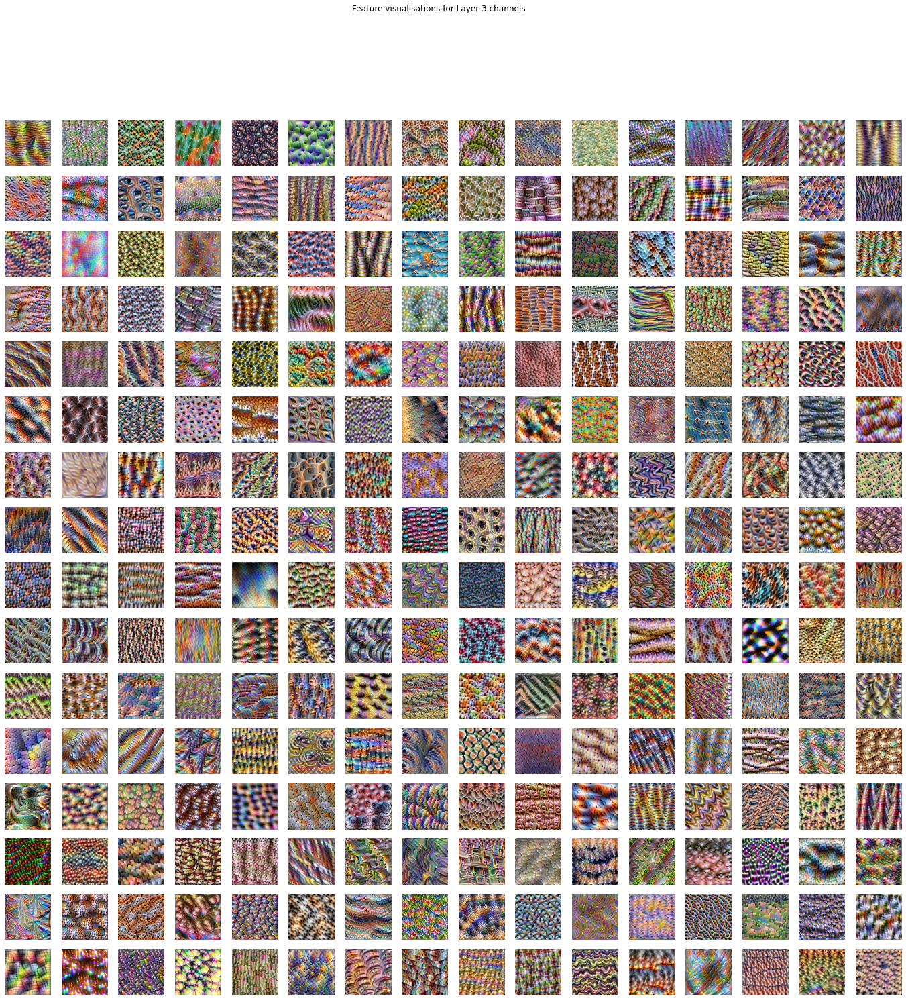

In [ ]:
fig, ax = plt.subplots(16, 16, figsize = (24, 24))
fig.suptitle('Feature visualisations for Layer 3 channels')
for i in range(16):
  for j in range(16):
    ax[i][j].axis('off')
    ax[i][j].imshow(images[16*i+j])

## Layer 4

In [ ]:
param_f = lambda: param.image(224)

layer = 'layer4'
n_channels = 512

images = []

for n in range(n_channels):
  print(f"{n+1}/{n_channels}")
  obj = objectives.channel(layer, n)
  image = render.render_vis(model, obj, param_f)
  images.append(image[0][0])

1/512


100%|██████████| 512/512 [00:26<00:00, 19.32it/s]


2/512


100%|██████████| 512/512 [00:25<00:00, 20.15it/s]


3/512


100%|██████████| 512/512 [00:27<00:00, 18.91it/s]


4/512


100%|██████████| 512/512 [00:24<00:00, 21.26it/s]


5/512


100%|██████████| 512/512 [00:24<00:00, 21.21it/s]


6/512


100%|██████████| 512/512 [00:23<00:00, 21.35it/s]


7/512


100%|██████████| 512/512 [00:24<00:00, 21.13it/s]


8/512


100%|██████████| 512/512 [00:24<00:00, 21.16it/s]


9/512


100%|██████████| 512/512 [00:24<00:00, 20.82it/s]


10/512


100%|██████████| 512/512 [00:23<00:00, 21.45it/s]


11/512


100%|██████████| 512/512 [00:23<00:00, 21.61it/s]


12/512


100%|██████████| 512/512 [00:23<00:00, 21.46it/s]


13/512


100%|██████████| 512/512 [00:23<00:00, 21.38it/s]


14/512


100%|██████████| 512/512 [00:24<00:00, 21.29it/s]


15/512


100%|██████████| 512/512 [00:24<00:00, 21.20it/s]


16/512


100%|██████████| 512/512 [00:24<00:00, 20.55it/s]


17/512


100%|██████████| 512/512 [00:24<00:00, 21.14it/s]


18/512


100%|██████████| 512/512 [00:24<00:00, 20.86it/s]


19/512


100%|██████████| 512/512 [00:24<00:00, 20.93it/s]


20/512


100%|██████████| 512/512 [00:24<00:00, 21.22it/s]


21/512


100%|██████████| 512/512 [00:24<00:00, 21.01it/s]


22/512


100%|██████████| 512/512 [00:24<00:00, 20.91it/s]


23/512


100%|██████████| 512/512 [00:24<00:00, 21.17it/s]


24/512


100%|██████████| 512/512 [00:24<00:00, 21.01it/s]


25/512


100%|██████████| 512/512 [00:24<00:00, 20.81it/s]


26/512


100%|██████████| 512/512 [00:24<00:00, 20.89it/s]


27/512


100%|██████████| 512/512 [00:24<00:00, 21.08it/s]


28/512


100%|██████████| 512/512 [00:24<00:00, 20.63it/s]


29/512


100%|██████████| 512/512 [00:25<00:00, 20.46it/s]


30/512


100%|██████████| 512/512 [00:24<00:00, 20.57it/s]


31/512


100%|██████████| 512/512 [00:24<00:00, 20.58it/s]


32/512


100%|██████████| 512/512 [00:24<00:00, 20.50it/s]


33/512


100%|██████████| 512/512 [00:24<00:00, 20.54it/s]


34/512


100%|██████████| 512/512 [00:24<00:00, 20.64it/s]


35/512


100%|██████████| 512/512 [00:25<00:00, 20.44it/s]


36/512


100%|██████████| 512/512 [00:24<00:00, 20.49it/s]


37/512


100%|██████████| 512/512 [00:24<00:00, 20.74it/s]


38/512


100%|██████████| 512/512 [00:25<00:00, 20.42it/s]


39/512


100%|██████████| 512/512 [00:24<00:00, 20.63it/s]


40/512


100%|██████████| 512/512 [00:24<00:00, 20.62it/s]


41/512


100%|██████████| 512/512 [00:25<00:00, 20.16it/s]


42/512


100%|██████████| 512/512 [00:25<00:00, 20.37it/s]


43/512


100%|██████████| 512/512 [00:25<00:00, 20.14it/s]


44/512


100%|██████████| 512/512 [00:25<00:00, 20.45it/s]


45/512


100%|██████████| 512/512 [00:25<00:00, 20.47it/s]


46/512


100%|██████████| 512/512 [00:24<00:00, 20.55it/s]


47/512


100%|██████████| 512/512 [00:24<00:00, 20.51it/s]


48/512


100%|██████████| 512/512 [00:25<00:00, 20.40it/s]


49/512


100%|██████████| 512/512 [00:24<00:00, 20.67it/s]


50/512


100%|██████████| 512/512 [00:25<00:00, 20.33it/s]


51/512


100%|██████████| 512/512 [00:24<00:00, 20.48it/s]


52/512


100%|██████████| 512/512 [00:24<00:00, 20.54it/s]


53/512


100%|██████████| 512/512 [00:25<00:00, 20.27it/s]


54/512


100%|██████████| 512/512 [00:25<00:00, 20.32it/s]


55/512


100%|██████████| 512/512 [00:25<00:00, 20.37it/s]


56/512


100%|██████████| 512/512 [00:25<00:00, 20.47it/s]


57/512


100%|██████████| 512/512 [00:25<00:00, 19.99it/s]


58/512


100%|██████████| 512/512 [00:25<00:00, 19.97it/s]


59/512


100%|██████████| 512/512 [00:25<00:00, 20.16it/s]


60/512


100%|██████████| 512/512 [00:25<00:00, 20.15it/s]


61/512


100%|██████████| 512/512 [00:25<00:00, 20.31it/s]


62/512


100%|██████████| 512/512 [00:25<00:00, 20.20it/s]


63/512


100%|██████████| 512/512 [00:25<00:00, 20.24it/s]


64/512


100%|██████████| 512/512 [00:25<00:00, 20.13it/s]


65/512


100%|██████████| 512/512 [00:25<00:00, 20.15it/s]


66/512


100%|██████████| 512/512 [00:25<00:00, 20.05it/s]


67/512


100%|██████████| 512/512 [00:25<00:00, 19.99it/s]


68/512


100%|██████████| 512/512 [00:25<00:00, 19.77it/s]


69/512


100%|██████████| 512/512 [00:25<00:00, 19.77it/s]


70/512


100%|██████████| 512/512 [00:25<00:00, 20.46it/s]


71/512


100%|██████████| 512/512 [00:25<00:00, 20.36it/s]


72/512


100%|██████████| 512/512 [00:25<00:00, 20.14it/s]


73/512


100%|██████████| 512/512 [00:25<00:00, 20.44it/s]


74/512


100%|██████████| 512/512 [00:25<00:00, 19.70it/s]


75/512


100%|██████████| 512/512 [00:29<00:00, 17.52it/s]


76/512


100%|██████████| 512/512 [00:28<00:00, 18.21it/s]


77/512


100%|██████████| 512/512 [00:26<00:00, 19.49it/s]


78/512


100%|██████████| 512/512 [00:26<00:00, 19.50it/s]


79/512


100%|██████████| 512/512 [00:26<00:00, 19.47it/s]


80/512


100%|██████████| 512/512 [00:26<00:00, 19.43it/s]


81/512


100%|██████████| 512/512 [00:26<00:00, 19.24it/s]


82/512


100%|██████████| 512/512 [00:26<00:00, 19.60it/s]


83/512


100%|██████████| 512/512 [00:26<00:00, 19.53it/s]


84/512


100%|██████████| 512/512 [00:25<00:00, 19.72it/s]


85/512


100%|██████████| 512/512 [00:26<00:00, 19.53it/s]


86/512


100%|██████████| 512/512 [00:26<00:00, 19.25it/s]


87/512


100%|██████████| 512/512 [00:26<00:00, 19.28it/s]


88/512


100%|██████████| 512/512 [00:26<00:00, 19.35it/s]


89/512


100%|██████████| 512/512 [00:26<00:00, 19.18it/s]


90/512


100%|██████████| 512/512 [00:26<00:00, 19.41it/s]


91/512


100%|██████████| 512/512 [00:26<00:00, 19.27it/s]


92/512


100%|██████████| 512/512 [00:27<00:00, 18.83it/s]


93/512


100%|██████████| 512/512 [00:26<00:00, 19.46it/s]


94/512


100%|██████████| 512/512 [00:26<00:00, 19.39it/s]


95/512


100%|██████████| 512/512 [00:26<00:00, 19.26it/s]


96/512


100%|██████████| 512/512 [00:26<00:00, 19.35it/s]


97/512


100%|██████████| 512/512 [00:28<00:00, 18.07it/s]


98/512


100%|██████████| 512/512 [00:27<00:00, 18.38it/s]


99/512


100%|██████████| 512/512 [00:26<00:00, 19.19it/s]


100/512


100%|██████████| 512/512 [00:26<00:00, 19.00it/s]


101/512


100%|██████████| 512/512 [00:27<00:00, 18.68it/s]


102/512


100%|██████████| 512/512 [00:26<00:00, 19.19it/s]


103/512


100%|██████████| 512/512 [00:27<00:00, 18.90it/s]


104/512


100%|██████████| 512/512 [00:26<00:00, 19.10it/s]


105/512


100%|██████████| 512/512 [00:27<00:00, 18.68it/s]


106/512


100%|██████████| 512/512 [00:27<00:00, 18.95it/s]


107/512


100%|██████████| 512/512 [00:26<00:00, 19.04it/s]


108/512


100%|██████████| 512/512 [00:27<00:00, 18.74it/s]


109/512


100%|██████████| 512/512 [00:28<00:00, 18.08it/s]


110/512


100%|██████████| 512/512 [00:27<00:00, 18.56it/s]


111/512


100%|██████████| 512/512 [00:26<00:00, 19.10it/s]


112/512


100%|██████████| 512/512 [00:27<00:00, 18.65it/s]


113/512


100%|██████████| 512/512 [00:27<00:00, 18.39it/s]


114/512


100%|██████████| 512/512 [00:27<00:00, 18.94it/s]


115/512


100%|██████████| 512/512 [00:27<00:00, 18.85it/s]


116/512


100%|██████████| 512/512 [00:27<00:00, 18.89it/s]


117/512


100%|██████████| 512/512 [00:27<00:00, 18.47it/s]


118/512


100%|██████████| 512/512 [00:27<00:00, 18.85it/s]


119/512


100%|██████████| 512/512 [00:27<00:00, 18.81it/s]


120/512


100%|██████████| 512/512 [00:27<00:00, 18.81it/s]


121/512


100%|██████████| 512/512 [00:27<00:00, 18.34it/s]


122/512


100%|██████████| 512/512 [00:27<00:00, 18.65it/s]


123/512


100%|██████████| 512/512 [00:27<00:00, 18.60it/s]


124/512


100%|██████████| 512/512 [00:28<00:00, 17.96it/s]


125/512


100%|██████████| 512/512 [00:27<00:00, 18.68it/s]


126/512


100%|██████████| 512/512 [00:27<00:00, 18.58it/s]


127/512


100%|██████████| 512/512 [00:27<00:00, 18.49it/s]


128/512


100%|██████████| 512/512 [00:28<00:00, 18.12it/s]


129/512


100%|██████████| 512/512 [00:27<00:00, 18.59it/s]


130/512


100%|██████████| 512/512 [00:27<00:00, 18.43it/s]


131/512


100%|██████████| 512/512 [00:28<00:00, 18.04it/s]


132/512


100%|██████████| 512/512 [00:27<00:00, 18.53it/s]


133/512


100%|██████████| 512/512 [00:27<00:00, 18.36it/s]


134/512


100%|██████████| 512/512 [00:28<00:00, 18.17it/s]


135/512


100%|██████████| 512/512 [00:28<00:00, 18.20it/s]


136/512


100%|██████████| 512/512 [00:28<00:00, 18.25it/s]


137/512


100%|██████████| 512/512 [00:27<00:00, 18.30it/s]


138/512


100%|██████████| 512/512 [00:28<00:00, 18.08it/s]


139/512


100%|██████████| 512/512 [00:28<00:00, 18.20it/s]


140/512


100%|██████████| 512/512 [00:28<00:00, 18.17it/s]


141/512


100%|██████████| 512/512 [00:28<00:00, 17.95it/s]


142/512


100%|██████████| 512/512 [00:28<00:00, 18.21it/s]


143/512


100%|██████████| 512/512 [00:27<00:00, 18.37it/s]


144/512


100%|██████████| 512/512 [00:29<00:00, 17.63it/s]


145/512


100%|██████████| 512/512 [00:28<00:00, 18.14it/s]


146/512


100%|██████████| 512/512 [00:28<00:00, 18.05it/s]


147/512


100%|██████████| 512/512 [00:28<00:00, 17.82it/s]


148/512


100%|██████████| 512/512 [00:28<00:00, 18.16it/s]


149/512


100%|██████████| 512/512 [00:28<00:00, 17.74it/s]


150/512


100%|██████████| 512/512 [00:28<00:00, 17.98it/s]


151/512


100%|██████████| 512/512 [00:28<00:00, 18.27it/s]


152/512


100%|██████████| 512/512 [00:28<00:00, 17.73it/s]


153/512


100%|██████████| 512/512 [00:28<00:00, 18.07it/s]


154/512


100%|██████████| 512/512 [00:28<00:00, 18.09it/s]


155/512


100%|██████████| 512/512 [00:29<00:00, 17.65it/s]


156/512


100%|██████████| 512/512 [00:28<00:00, 17.90it/s]


157/512


100%|██████████| 512/512 [00:28<00:00, 17.92it/s]


158/512


100%|██████████| 512/512 [00:29<00:00, 17.58it/s]


159/512


100%|██████████| 512/512 [00:28<00:00, 17.91it/s]


160/512


100%|██████████| 512/512 [00:28<00:00, 17.82it/s]


161/512


100%|██████████| 512/512 [00:29<00:00, 17.60it/s]


162/512


100%|██████████| 512/512 [00:28<00:00, 17.96it/s]


163/512


100%|██████████| 512/512 [00:29<00:00, 17.54it/s]


164/512


100%|██████████| 512/512 [00:28<00:00, 17.76it/s]


165/512


100%|██████████| 512/512 [00:28<00:00, 17.87it/s]


166/512


100%|██████████| 512/512 [00:29<00:00, 17.55it/s]


167/512


100%|██████████| 512/512 [00:28<00:00, 17.70it/s]


168/512


100%|██████████| 512/512 [00:29<00:00, 17.51it/s]


169/512


100%|██████████| 512/512 [00:28<00:00, 17.78it/s]


170/512


100%|██████████| 512/512 [00:28<00:00, 17.83it/s]


171/512


100%|██████████| 512/512 [00:29<00:00, 17.37it/s]


172/512


100%|██████████| 512/512 [00:29<00:00, 17.55it/s]


173/512


100%|██████████| 512/512 [00:29<00:00, 17.22it/s]


174/512


100%|██████████| 512/512 [00:28<00:00, 17.66it/s]


175/512


100%|██████████| 512/512 [00:29<00:00, 17.65it/s]


176/512


100%|██████████| 512/512 [00:29<00:00, 17.32it/s]


177/512


100%|██████████| 512/512 [00:28<00:00, 17.70it/s]


178/512


100%|██████████| 512/512 [00:29<00:00, 17.11it/s]


179/512


100%|██████████| 512/512 [00:28<00:00, 17.76it/s]


180/512


100%|██████████| 512/512 [00:29<00:00, 17.42it/s]


181/512


100%|██████████| 512/512 [00:29<00:00, 17.29it/s]


182/512


100%|██████████| 512/512 [00:29<00:00, 17.56it/s]


183/512


100%|██████████| 512/512 [00:30<00:00, 17.02it/s]


184/512


100%|██████████| 512/512 [00:29<00:00, 17.52it/s]


185/512


100%|██████████| 512/512 [00:29<00:00, 17.10it/s]


186/512


100%|██████████| 512/512 [00:28<00:00, 17.66it/s]


187/512


100%|██████████| 512/512 [00:29<00:00, 17.58it/s]


188/512


100%|██████████| 512/512 [00:30<00:00, 16.96it/s]


189/512


100%|██████████| 512/512 [00:29<00:00, 17.57it/s]


190/512


100%|██████████| 512/512 [00:32<00:00, 15.56it/s]


191/512


100%|██████████| 512/512 [00:33<00:00, 15.49it/s]


192/512


100%|██████████| 512/512 [00:33<00:00, 15.27it/s]


193/512


100%|██████████| 512/512 [00:32<00:00, 15.97it/s]


194/512


100%|██████████| 512/512 [00:32<00:00, 15.69it/s]


195/512


100%|██████████| 512/512 [00:34<00:00, 14.93it/s]


196/512


100%|██████████| 512/512 [00:35<00:00, 14.26it/s]


197/512


100%|██████████| 512/512 [00:34<00:00, 14.67it/s]


198/512


100%|██████████| 512/512 [00:34<00:00, 15.04it/s]


199/512


100%|██████████| 512/512 [00:34<00:00, 15.06it/s]


200/512


100%|██████████| 512/512 [00:30<00:00, 16.71it/s]


201/512


100%|██████████| 512/512 [00:29<00:00, 17.21it/s]


202/512


100%|██████████| 512/512 [00:30<00:00, 16.92it/s]


203/512


100%|██████████| 512/512 [00:29<00:00, 17.27it/s]


204/512


100%|██████████| 512/512 [00:30<00:00, 16.87it/s]


205/512


100%|██████████| 512/512 [00:29<00:00, 17.38it/s]


206/512


100%|██████████| 512/512 [00:30<00:00, 16.76it/s]


207/512


100%|██████████| 512/512 [00:29<00:00, 17.16it/s]


208/512


100%|██████████| 512/512 [00:30<00:00, 16.74it/s]


209/512


100%|██████████| 512/512 [00:29<00:00, 17.10it/s]


210/512


100%|██████████| 512/512 [00:30<00:00, 16.89it/s]


211/512


100%|██████████| 512/512 [00:29<00:00, 17.24it/s]


212/512


100%|██████████| 512/512 [00:30<00:00, 16.75it/s]


213/512


100%|██████████| 512/512 [00:29<00:00, 17.22it/s]


214/512


100%|██████████| 512/512 [00:30<00:00, 16.87it/s]


215/512


100%|██████████| 512/512 [00:29<00:00, 17.12it/s]


216/512


100%|██████████| 512/512 [00:30<00:00, 16.79it/s]


217/512


100%|██████████| 512/512 [00:30<00:00, 16.81it/s]


218/512


100%|██████████| 512/512 [00:30<00:00, 16.64it/s]


219/512


100%|██████████| 512/512 [00:29<00:00, 17.09it/s]


220/512


100%|██████████| 512/512 [00:30<00:00, 16.66it/s]


221/512


100%|██████████| 512/512 [00:29<00:00, 17.07it/s]


222/512


100%|██████████| 512/512 [00:30<00:00, 16.66it/s]


223/512


100%|██████████| 512/512 [00:30<00:00, 16.94it/s]


224/512


100%|██████████| 512/512 [00:30<00:00, 16.57it/s]


225/512


100%|██████████| 512/512 [00:30<00:00, 16.93it/s]


226/512


100%|██████████| 512/512 [00:30<00:00, 16.61it/s]


227/512


100%|██████████| 512/512 [00:30<00:00, 16.93it/s]


228/512


100%|██████████| 512/512 [00:31<00:00, 16.33it/s]


229/512


100%|██████████| 512/512 [00:30<00:00, 17.00it/s]


230/512


100%|██████████| 512/512 [00:31<00:00, 16.47it/s]


231/512


100%|██████████| 512/512 [00:30<00:00, 16.86it/s]


232/512


100%|██████████| 512/512 [00:31<00:00, 16.51it/s]


233/512


100%|██████████| 512/512 [00:30<00:00, 16.86it/s]


234/512


100%|██████████| 512/512 [00:31<00:00, 16.49it/s]


235/512


100%|██████████| 512/512 [00:30<00:00, 16.71it/s]


236/512


100%|██████████| 512/512 [00:31<00:00, 16.41it/s]


237/512


100%|██████████| 512/512 [00:31<00:00, 16.41it/s]


238/512


100%|██████████| 512/512 [00:31<00:00, 16.44it/s]


239/512


100%|██████████| 512/512 [00:31<00:00, 16.34it/s]


240/512


100%|██████████| 512/512 [00:30<00:00, 16.68it/s]


241/512


100%|██████████| 512/512 [00:31<00:00, 16.31it/s]


242/512


100%|██████████| 512/512 [00:30<00:00, 16.59it/s]


243/512


100%|██████████| 512/512 [00:31<00:00, 16.31it/s]


244/512


100%|██████████| 512/512 [00:31<00:00, 16.10it/s]


245/512


100%|██████████| 512/512 [00:30<00:00, 16.70it/s]


246/512


100%|██████████| 512/512 [00:31<00:00, 16.11it/s]


247/512


100%|██████████| 512/512 [00:30<00:00, 16.65it/s]


248/512


100%|██████████| 512/512 [00:31<00:00, 16.05it/s]


249/512


100%|██████████| 512/512 [00:31<00:00, 16.05it/s]


250/512


100%|██████████| 512/512 [00:31<00:00, 16.44it/s]


251/512


100%|██████████| 512/512 [00:32<00:00, 15.92it/s]


252/512


100%|██████████| 512/512 [00:31<00:00, 16.32it/s]


253/512


100%|██████████| 512/512 [00:32<00:00, 15.96it/s]


254/512


100%|██████████| 512/512 [00:32<00:00, 16.00it/s]


255/512


100%|██████████| 512/512 [00:31<00:00, 16.34it/s]


256/512


100%|██████████| 512/512 [00:32<00:00, 15.85it/s]


257/512


100%|██████████| 512/512 [00:32<00:00, 15.78it/s]


258/512


100%|██████████| 512/512 [00:31<00:00, 16.28it/s]


259/512


100%|██████████| 512/512 [00:32<00:00, 15.90it/s]


260/512


100%|██████████| 512/512 [00:31<00:00, 16.26it/s]


261/512


100%|██████████| 512/512 [00:31<00:00, 16.10it/s]


262/512


100%|██████████| 512/512 [00:32<00:00, 15.94it/s]


263/512


100%|██████████| 512/512 [00:31<00:00, 16.13it/s]


264/512


100%|██████████| 512/512 [00:32<00:00, 15.81it/s]


265/512


100%|██████████| 512/512 [00:32<00:00, 15.61it/s]


266/512


100%|██████████| 512/512 [00:32<00:00, 15.88it/s]


267/512


100%|██████████| 512/512 [00:32<00:00, 15.94it/s]


268/512


100%|██████████| 512/512 [00:32<00:00, 15.69it/s]


269/512


100%|██████████| 512/512 [00:31<00:00, 16.20it/s]


270/512


100%|██████████| 512/512 [00:32<00:00, 15.78it/s]


271/512


100%|██████████| 512/512 [00:32<00:00, 15.83it/s]


272/512


100%|██████████| 512/512 [00:32<00:00, 15.89it/s]


273/512


100%|██████████| 512/512 [00:32<00:00, 15.83it/s]


274/512


100%|██████████| 512/512 [00:32<00:00, 15.63it/s]


275/512


100%|██████████| 512/512 [00:31<00:00, 16.19it/s]


276/512


100%|██████████| 512/512 [00:32<00:00, 15.60it/s]


277/512


100%|██████████| 512/512 [00:32<00:00, 15.53it/s]


278/512


100%|██████████| 512/512 [00:32<00:00, 15.98it/s]


279/512


100%|██████████| 512/512 [00:32<00:00, 15.65it/s]


280/512


100%|██████████| 512/512 [00:32<00:00, 15.72it/s]


281/512


100%|██████████| 512/512 [00:32<00:00, 15.95it/s]


282/512


100%|██████████| 512/512 [00:32<00:00, 15.87it/s]


283/512


100%|██████████| 512/512 [00:32<00:00, 15.63it/s]


284/512


100%|██████████| 512/512 [00:32<00:00, 15.74it/s]


285/512


100%|██████████| 512/512 [00:32<00:00, 15.87it/s]


286/512


100%|██████████| 512/512 [00:33<00:00, 15.51it/s]


287/512


100%|██████████| 512/512 [00:33<00:00, 15.51it/s]


288/512


100%|██████████| 512/512 [00:32<00:00, 15.84it/s]


289/512


100%|██████████| 512/512 [00:33<00:00, 15.49it/s]


290/512


100%|██████████| 512/512 [00:32<00:00, 15.54it/s]


291/512


100%|██████████| 512/512 [00:32<00:00, 15.82it/s]


292/512


100%|██████████| 512/512 [00:32<00:00, 15.57it/s]


293/512


100%|██████████| 512/512 [00:32<00:00, 15.61it/s]


294/512


100%|██████████| 512/512 [00:32<00:00, 15.58it/s]


295/512


100%|██████████| 512/512 [00:32<00:00, 15.81it/s]


296/512


100%|██████████| 512/512 [00:33<00:00, 15.33it/s]


297/512


100%|██████████| 512/512 [00:32<00:00, 15.54it/s]


298/512


100%|██████████| 512/512 [00:32<00:00, 15.84it/s]


299/512


100%|██████████| 512/512 [00:33<00:00, 15.42it/s]


300/512


100%|██████████| 512/512 [00:33<00:00, 15.49it/s]


301/512


100%|██████████| 512/512 [00:33<00:00, 15.38it/s]


302/512


100%|██████████| 512/512 [00:32<00:00, 15.62it/s]


303/512


100%|██████████| 512/512 [00:33<00:00, 15.21it/s]


304/512


100%|██████████| 512/512 [00:33<00:00, 15.32it/s]


305/512


100%|██████████| 512/512 [00:33<00:00, 15.41it/s]


306/512


100%|██████████| 512/512 [00:33<00:00, 15.30it/s]


307/512


100%|██████████| 512/512 [00:33<00:00, 15.43it/s]


308/512


100%|██████████| 512/512 [00:33<00:00, 15.29it/s]


309/512


100%|██████████| 512/512 [00:33<00:00, 15.21it/s]


310/512


100%|██████████| 512/512 [00:32<00:00, 15.58it/s]


311/512


100%|██████████| 512/512 [00:33<00:00, 15.20it/s]


312/512


100%|██████████| 512/512 [00:34<00:00, 15.03it/s]


313/512


100%|██████████| 512/512 [00:33<00:00, 15.08it/s]


314/512


100%|██████████| 512/512 [00:33<00:00, 15.46it/s]


315/512


100%|██████████| 512/512 [00:35<00:00, 14.51it/s]


316/512


100%|██████████| 512/512 [00:36<00:00, 14.12it/s]


317/512


100%|██████████| 512/512 [00:34<00:00, 14.95it/s]


318/512


100%|██████████| 512/512 [00:33<00:00, 15.25it/s]


319/512


100%|██████████| 512/512 [00:33<00:00, 15.23it/s]


320/512


100%|██████████| 512/512 [00:33<00:00, 15.45it/s]


321/512


100%|██████████| 512/512 [00:33<00:00, 15.23it/s]


322/512


100%|██████████| 512/512 [00:33<00:00, 15.14it/s]


323/512


100%|██████████| 512/512 [00:34<00:00, 15.03it/s]


324/512


100%|██████████| 512/512 [00:34<00:00, 14.87it/s]


325/512


100%|██████████| 512/512 [00:33<00:00, 15.33it/s]


326/512


100%|██████████| 512/512 [00:34<00:00, 14.99it/s]


327/512


100%|██████████| 512/512 [00:33<00:00, 15.08it/s]


328/512


100%|██████████| 512/512 [00:34<00:00, 15.03it/s]


329/512


100%|██████████| 512/512 [00:34<00:00, 14.99it/s]


330/512


100%|██████████| 512/512 [00:33<00:00, 15.19it/s]


331/512


100%|██████████| 512/512 [00:34<00:00, 15.01it/s]


332/512


100%|██████████| 512/512 [00:34<00:00, 14.80it/s]


333/512


100%|██████████| 512/512 [00:34<00:00, 14.75it/s]


334/512


100%|██████████| 512/512 [00:34<00:00, 14.97it/s]


335/512


100%|██████████| 512/512 [00:34<00:00, 14.65it/s]


336/512


100%|██████████| 512/512 [00:33<00:00, 15.12it/s]


337/512


100%|██████████| 512/512 [00:34<00:00, 14.82it/s]


338/512


100%|██████████| 512/512 [00:34<00:00, 14.72it/s]


339/512


100%|██████████| 512/512 [00:34<00:00, 14.73it/s]


340/512


100%|██████████| 512/512 [00:34<00:00, 14.81it/s]


341/512


100%|██████████| 512/512 [00:34<00:00, 14.89it/s]


342/512


100%|██████████| 512/512 [00:35<00:00, 14.56it/s]


343/512


100%|██████████| 512/512 [00:33<00:00, 15.21it/s]


344/512


100%|██████████| 512/512 [00:34<00:00, 14.85it/s]


345/512


100%|██████████| 512/512 [00:34<00:00, 14.91it/s]


346/512


100%|██████████| 512/512 [00:34<00:00, 14.85it/s]


347/512


100%|██████████| 512/512 [00:34<00:00, 14.86it/s]


348/512


100%|██████████| 512/512 [00:34<00:00, 14.80it/s]


349/512


100%|██████████| 512/512 [00:33<00:00, 15.15it/s]


350/512


100%|██████████| 512/512 [00:34<00:00, 14.81it/s]


351/512


100%|██████████| 512/512 [00:35<00:00, 14.50it/s]


352/512


100%|██████████| 512/512 [00:35<00:00, 14.61it/s]


353/512


100%|██████████| 512/512 [00:34<00:00, 14.65it/s]


354/512


100%|██████████| 512/512 [00:34<00:00, 14.65it/s]


355/512


100%|██████████| 512/512 [00:34<00:00, 14.71it/s]


356/512


100%|██████████| 512/512 [00:34<00:00, 14.66it/s]


357/512


100%|██████████| 512/512 [00:34<00:00, 14.86it/s]


358/512


100%|██████████| 512/512 [00:34<00:00, 14.66it/s]


359/512


100%|██████████| 512/512 [00:35<00:00, 14.54it/s]


360/512


100%|██████████| 512/512 [00:35<00:00, 14.43it/s]


361/512


100%|██████████| 512/512 [00:34<00:00, 14.64it/s]


362/512


100%|██████████| 512/512 [00:35<00:00, 14.45it/s]


363/512


100%|██████████| 512/512 [00:35<00:00, 14.45it/s]


364/512


100%|██████████| 512/512 [00:35<00:00, 14.57it/s]


365/512


100%|██████████| 512/512 [00:35<00:00, 14.49it/s]


366/512


100%|██████████| 512/512 [00:35<00:00, 14.33it/s]


367/512


100%|██████████| 512/512 [00:36<00:00, 14.01it/s]


368/512


100%|██████████| 512/512 [00:36<00:00, 14.14it/s]


369/512


100%|██████████| 512/512 [00:36<00:00, 13.99it/s]


370/512


100%|██████████| 512/512 [00:35<00:00, 14.27it/s]


371/512


100%|██████████| 512/512 [00:35<00:00, 14.24it/s]


372/512


100%|██████████| 512/512 [00:36<00:00, 14.07it/s]


373/512


100%|██████████| 512/512 [00:36<00:00, 14.13it/s]


374/512


100%|██████████| 512/512 [00:36<00:00, 14.07it/s]


375/512


100%|██████████| 512/512 [00:36<00:00, 14.14it/s]


376/512


100%|██████████| 512/512 [00:36<00:00, 14.11it/s]


377/512


100%|██████████| 512/512 [00:36<00:00, 13.90it/s]


378/512


100%|██████████| 512/512 [00:36<00:00, 14.03it/s]


379/512


100%|██████████| 512/512 [00:35<00:00, 14.30it/s]


380/512


100%|██████████| 512/512 [00:35<00:00, 14.23it/s]


381/512


100%|██████████| 512/512 [00:36<00:00, 14.05it/s]


382/512


100%|██████████| 512/512 [00:36<00:00, 13.85it/s]


383/512


100%|██████████| 512/512 [00:36<00:00, 14.04it/s]


384/512


100%|██████████| 512/512 [00:36<00:00, 14.16it/s]


385/512


100%|██████████| 512/512 [00:36<00:00, 14.18it/s]


386/512


100%|██████████| 512/512 [00:36<00:00, 14.08it/s]


387/512


100%|██████████| 512/512 [00:36<00:00, 14.08it/s]


388/512


100%|██████████| 512/512 [00:36<00:00, 14.13it/s]


389/512


100%|██████████| 512/512 [00:36<00:00, 13.95it/s]


390/512


100%|██████████| 512/512 [00:36<00:00, 14.18it/s]


391/512


100%|██████████| 512/512 [00:36<00:00, 14.00it/s]


392/512


100%|██████████| 512/512 [00:36<00:00, 14.10it/s]


393/512


100%|██████████| 512/512 [00:36<00:00, 14.07it/s]


394/512


100%|██████████| 512/512 [00:36<00:00, 13.98it/s]


395/512


100%|██████████| 512/512 [00:36<00:00, 14.18it/s]


396/512


100%|██████████| 512/512 [00:36<00:00, 14.05it/s]


397/512


100%|██████████| 512/512 [00:36<00:00, 14.20it/s]


398/512


100%|██████████| 512/512 [00:36<00:00, 14.10it/s]


399/512


100%|██████████| 512/512 [00:36<00:00, 14.18it/s]


400/512


100%|██████████| 512/512 [00:36<00:00, 14.20it/s]


401/512


100%|██████████| 512/512 [00:35<00:00, 14.28it/s]


402/512


100%|██████████| 512/512 [00:36<00:00, 14.18it/s]


403/512


100%|██████████| 512/512 [00:36<00:00, 14.08it/s]


404/512


100%|██████████| 512/512 [00:36<00:00, 14.01it/s]


405/512


100%|██████████| 512/512 [00:36<00:00, 14.03it/s]


406/512


100%|██████████| 512/512 [00:36<00:00, 14.10it/s]


407/512


100%|██████████| 512/512 [00:36<00:00, 14.06it/s]


408/512


100%|██████████| 512/512 [00:36<00:00, 14.00it/s]


409/512


100%|██████████| 512/512 [00:36<00:00, 13.96it/s]


410/512


100%|██████████| 512/512 [00:36<00:00, 14.15it/s]


411/512


100%|██████████| 512/512 [00:36<00:00, 13.99it/s]


412/512


100%|██████████| 512/512 [00:36<00:00, 14.06it/s]


413/512


100%|██████████| 512/512 [00:36<00:00, 14.10it/s]


414/512


100%|██████████| 512/512 [00:36<00:00, 14.05it/s]


415/512


100%|██████████| 512/512 [00:36<00:00, 14.11it/s]


416/512


100%|██████████| 512/512 [00:36<00:00, 13.94it/s]


417/512


100%|██████████| 512/512 [00:36<00:00, 13.99it/s]


418/512


100%|██████████| 512/512 [00:36<00:00, 14.06it/s]


419/512


100%|██████████| 512/512 [00:36<00:00, 13.99it/s]


420/512


100%|██████████| 512/512 [00:36<00:00, 13.86it/s]


421/512


100%|██████████| 512/512 [00:36<00:00, 14.03it/s]


422/512


100%|██████████| 512/512 [00:36<00:00, 14.00it/s]


423/512


100%|██████████| 512/512 [00:36<00:00, 14.00it/s]


424/512


100%|██████████| 512/512 [00:36<00:00, 13.91it/s]


425/512


100%|██████████| 512/512 [00:36<00:00, 13.86it/s]


426/512


100%|██████████| 512/512 [00:36<00:00, 13.91it/s]


427/512


100%|██████████| 512/512 [00:36<00:00, 13.90it/s]


428/512


100%|██████████| 512/512 [00:37<00:00, 13.80it/s]


429/512


100%|██████████| 512/512 [00:37<00:00, 13.83it/s]


430/512


100%|██████████| 512/512 [00:36<00:00, 13.85it/s]


431/512


100%|██████████| 512/512 [00:36<00:00, 14.09it/s]


432/512


100%|██████████| 512/512 [00:36<00:00, 14.13it/s]


433/512


100%|██████████| 512/512 [00:35<00:00, 14.52it/s]


434/512


100%|██████████| 512/512 [00:35<00:00, 14.54it/s]


435/512


100%|██████████| 512/512 [00:35<00:00, 14.53it/s]


436/512


100%|██████████| 512/512 [00:35<00:00, 14.46it/s]


437/512


100%|██████████| 512/512 [00:35<00:00, 14.31it/s]


438/512


100%|██████████| 512/512 [00:35<00:00, 14.49it/s]


439/512


100%|██████████| 512/512 [00:35<00:00, 14.51it/s]


440/512


100%|██████████| 512/512 [00:35<00:00, 14.38it/s]


441/512


100%|██████████| 512/512 [00:35<00:00, 14.56it/s]


442/512


100%|██████████| 512/512 [00:35<00:00, 14.46it/s]


443/512


100%|██████████| 512/512 [00:35<00:00, 14.50it/s]


444/512


100%|██████████| 512/512 [00:35<00:00, 14.50it/s]


445/512


100%|██████████| 512/512 [00:35<00:00, 14.41it/s]


446/512


100%|██████████| 512/512 [00:35<00:00, 14.40it/s]


447/512


100%|██████████| 512/512 [00:35<00:00, 14.41it/s]


448/512


100%|██████████| 512/512 [00:35<00:00, 14.34it/s]


449/512


100%|██████████| 512/512 [00:35<00:00, 14.45it/s]


450/512


100%|██████████| 512/512 [00:35<00:00, 14.46it/s]


451/512


100%|██████████| 512/512 [00:35<00:00, 14.48it/s]


452/512


100%|██████████| 512/512 [00:35<00:00, 14.34it/s]


453/512


100%|██████████| 512/512 [00:35<00:00, 14.53it/s]


454/512


100%|██████████| 512/512 [00:35<00:00, 14.27it/s]


455/512


100%|██████████| 512/512 [00:35<00:00, 14.44it/s]


456/512


100%|██████████| 512/512 [00:35<00:00, 14.34it/s]


457/512


100%|██████████| 512/512 [00:35<00:00, 14.41it/s]


458/512


100%|██████████| 512/512 [00:35<00:00, 14.24it/s]


459/512


100%|██████████| 512/512 [00:35<00:00, 14.29it/s]


460/512


100%|██████████| 512/512 [00:35<00:00, 14.41it/s]


461/512


100%|██████████| 512/512 [00:35<00:00, 14.26it/s]


462/512


100%|██████████| 512/512 [00:35<00:00, 14.30it/s]


463/512


100%|██████████| 512/512 [00:35<00:00, 14.24it/s]


464/512


100%|██████████| 512/512 [00:35<00:00, 14.29it/s]


465/512


100%|██████████| 512/512 [00:36<00:00, 14.16it/s]


466/512


100%|██████████| 512/512 [00:36<00:00, 14.13it/s]


467/512


100%|██████████| 512/512 [00:35<00:00, 14.24it/s]


468/512


100%|██████████| 512/512 [00:35<00:00, 14.22it/s]


469/512


100%|██████████| 512/512 [00:35<00:00, 14.23it/s]


470/512


100%|██████████| 512/512 [00:36<00:00, 14.10it/s]


471/512


100%|██████████| 512/512 [00:35<00:00, 14.53it/s]


472/512


100%|██████████| 512/512 [00:35<00:00, 14.47it/s]


473/512


100%|██████████| 512/512 [00:35<00:00, 14.25it/s]


474/512


100%|██████████| 512/512 [00:38<00:00, 13.47it/s]


475/512


100%|██████████| 512/512 [00:40<00:00, 12.58it/s]


476/512


100%|██████████| 512/512 [00:41<00:00, 12.37it/s]


477/512


100%|██████████| 512/512 [00:39<00:00, 12.95it/s]


478/512


100%|██████████| 512/512 [00:41<00:00, 12.25it/s]


479/512


100%|██████████| 512/512 [00:44<00:00, 11.59it/s]


480/512


100%|██████████| 512/512 [00:42<00:00, 11.98it/s]


481/512


100%|██████████| 512/512 [00:41<00:00, 12.27it/s]


482/512


100%|██████████| 512/512 [00:40<00:00, 12.62it/s]


483/512


100%|██████████| 512/512 [00:37<00:00, 13.81it/s]


484/512


100%|██████████| 512/512 [00:37<00:00, 13.75it/s]


485/512


100%|██████████| 512/512 [00:37<00:00, 13.75it/s]


486/512


100%|██████████| 512/512 [00:37<00:00, 13.79it/s]


487/512


100%|██████████| 512/512 [00:37<00:00, 13.80it/s]


488/512


100%|██████████| 512/512 [00:37<00:00, 13.61it/s]


489/512


100%|██████████| 512/512 [00:38<00:00, 13.30it/s]


490/512


100%|██████████| 512/512 [00:38<00:00, 13.39it/s]


491/512


100%|██████████| 512/512 [00:37<00:00, 13.77it/s]


492/512


100%|██████████| 512/512 [00:37<00:00, 13.58it/s]


493/512


100%|██████████| 512/512 [00:37<00:00, 13.69it/s]


494/512


100%|██████████| 512/512 [00:37<00:00, 13.76it/s]


495/512


100%|██████████| 512/512 [00:37<00:00, 13.71it/s]


496/512


100%|██████████| 512/512 [00:38<00:00, 13.21it/s]


497/512


100%|██████████| 512/512 [00:38<00:00, 13.40it/s]


498/512


100%|██████████| 512/512 [00:37<00:00, 13.51it/s]


499/512


100%|██████████| 512/512 [00:38<00:00, 13.23it/s]


500/512


100%|██████████| 512/512 [00:37<00:00, 13.60it/s]


501/512


100%|██████████| 512/512 [00:38<00:00, 13.32it/s]


502/512


100%|██████████| 512/512 [00:39<00:00, 13.11it/s]


503/512


100%|██████████| 512/512 [00:37<00:00, 13.51it/s]


504/512


100%|██████████| 512/512 [00:37<00:00, 13.61it/s]


505/512


100%|██████████| 512/512 [00:38<00:00, 13.39it/s]


506/512


100%|██████████| 512/512 [00:38<00:00, 13.47it/s]


507/512


100%|██████████| 512/512 [00:38<00:00, 13.38it/s]


508/512


100%|██████████| 512/512 [00:39<00:00, 13.04it/s]


509/512


100%|██████████| 512/512 [00:38<00:00, 13.47it/s]


510/512


100%|██████████| 512/512 [00:37<00:00, 13.52it/s]


511/512


100%|██████████| 512/512 [00:38<00:00, 13.37it/s]


512/512


100%|██████████| 512/512 [00:38<00:00, 13.40it/s]


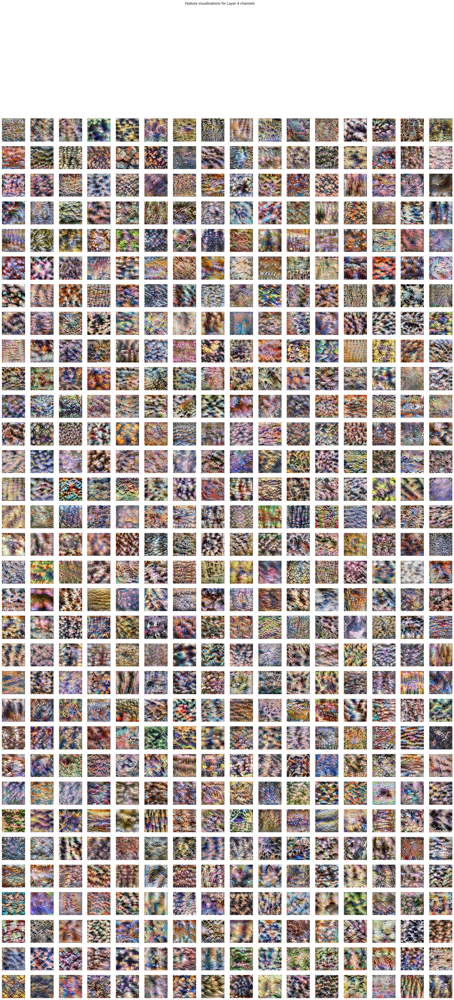

In [ ]:
fig, ax = plt.subplots(32, 16, figsize = (30, 24))
fig.suptitle('Feature visualisations for Layer 4 channels')
for i in range(32):
  for j in range(16):
    ax[i][j].axis('off')
    ax[i][j].imshow(images[16*i+j])